## Adding a lock to a simplified graph

In [1]:
import datetime
import pytest
import shapely
import simpy
import numpy as np
import pandas as pd
import xarray as xr

import opentnsim.core as core
import opentnsim.output as output
import opentnsim.vessel_traffic_service
import opentnsim.fis

import opentnsim.lock
import networkx as nx

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.tri as tri

import folium

* Vessel generator function
* Initialise environment
* Create graph
* Add hydrodynamic data
* Add lock(s)
* Generate vessel(s)
* Run simulation
* Inspect results

#### Vessel generator function

In [2]:
def create_vessel(env, name, origin, destination, vessel_type, L, B, T, v, arrival_time):
    Vessel = type(
        "Vessel",
        (
            opentnsim.lock.HasLock,
            opentnsim.lock.HasLineUpArea,
            opentnsim.lock.HasWaitingArea,
            core.Movable,
            core.VesselProperties,
            output.HasOutput,
            opentnsim.lock.CustomLog,
            core.Identifiable,
            core.SimpyObject,
            core.ExtraMetadata,
        ),
        {},
    )

    node = env.FG.nodes[origin]
    geometry = node["geometry"]
    vessel = Vessel(
        **{
            "env": env,
            "name": name,
            "origin": origin,
            "destination": destination,
            "geometry": geometry,
            "node": origin,
            "route": nx.dijkstra_path(env.FG, origin, destination),
            "type": vessel_type,
            "L": L,
            "B": B,
            "T": T,
            "v": v,
            "arrival_time": arrival_time,
        }
    )

    env.process(vessel.move())
    return vessel

#### Initialise environment

In [3]:
t_start = datetime.datetime(2024, 1, 1, 0, 0, 0)
t_stop = datetime.datetime(2024, 2, 1, 0, 0, 0)
env = simpy.Environment(initial_time=t_start.timestamp())

env.epoch = t_start
env.simulation_start = t_start
env.simulation_stop = t_stop

#### Create graph

In [4]:
FG = nx.DiGraph()
Node = type("Site", (core.Identifiable, core.Log, core.Locatable, core.HasResource), {})
coordinates = [(0, 0), (1200, 0)]
for index, coord in enumerate(coordinates):
    x, y = coord
    geometry = shapely.geometry.Point(x, y)
    node = Node(**{"env": [], "name": index, "geometry": geometry})
    FG.add_node(node.name, geometry=node.geometry, name=index, Info={"geometry": geometry})

edges = [(FG.nodes[0], FG.nodes[1]), (FG.nodes[1], FG.nodes[0])]
for node_start, node_stop in edges:
    geometry = shapely.LineString([node_start["geometry"], node_stop["geometry"]])

    FG.add_edge(
        node_start["name"],
        node_stop["name"],
        weight=1,
        geometry=geometry,
        Info={"geometry": geometry, "length": geometry.length},
    )

env.FG = FG

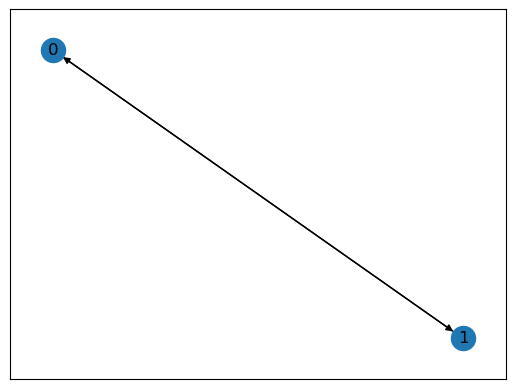

In [5]:
nx.draw_networkx(FG, pos=None, arrows=None)

#### Add hydrodynamic data

In [6]:
t_end = env.simulation_stop

stations = list(env.FG.nodes)
times = np.arange(env.epoch, t_end, datetime.timedelta(seconds=600))
water_depth = [np.linspace(10, 10, len(times)), np.linspace(10, 10, len(times))]
water_level = [np.linspace(0, 0, len(times)), np.linspace(1, 1, len(times))]
salinity = [np.linspace(0, 0, len(times)), np.linspace(0, 0, len(times))]

station_data = xr.DataArray(data=stations, dims=["STATIONS"])
time_data = xr.DataArray(data=times, dims=["TIME"])
depth_data = xr.DataArray(data=water_depth, dims=["STATIONS", "TIME"])
water_level_data = xr.DataArray(data=[wlev for wlev in water_level], dims=["STATIONS", "TIME"])
salinity_data = xr.DataArray(data=[sal for sal in salinity], dims=["STATIONS", "TIME"])

hydrodynamic_data = xr.Dataset(
    {"TIME": time_data, "Stations": station_data, "MBL": depth_data, "Water level": water_level_data, "Salinity": salinity_data}
)

env.vessel_traffic_service = opentnsim.vessel_traffic_service.VesselTrafficService(hydrodynamic_data)

C:\Users\floorbakker\AppData\Local\Temp\ipykernel_6904\3112945959.py:10: UserWarning:

Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting the values to nanosecond precision ahead of time.



#### Add lock

In [7]:
lock = opentnsim.lock.IsLock(
    env=env,
    name="Lock",
    lock_length=400,
    lock_width=40,
    lock_depth=10,
    node_doors1=0,
    node_doors2=1,
    distance_doors1_from_first_waiting_area=400,
    distance_doors2_from_second_waiting_area=400,
    speed_reduction_factor=1,
    detector_nodes=[0, 1],
)
opentnsim.lock.IsLockLineUpArea(
    env=env, name="Lock", distance_to_lock_doors=0, start_node=0, end_node=1, lineup_length=400, speed_reduction_factor=1
)
opentnsim.lock.IsLockLineUpArea(
    env=env, name="Lock", distance_to_lock_doors=0, start_node=1, end_node=0, lineup_length=400, speed_reduction_factor=1
)
opentnsim.lock.IsLockWaitingArea(env=env, name="Lock", distance_from_node=0, node=0)
opentnsim.lock.IsLockWaitingArea(env=env, name="Lock", distance_from_node=0, node=1)

env.lock = lock

c:\users\floorbakker\opentnsim\opentnsim\lock.py:428: UserWarning:

Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting the values to nanosecond precision ahead of time.



#### Generate vessel

In [8]:
vessel = create_vessel(env, 'vessel1', 0, 1, None, 200, 30, 8, 4, arrival_time=datetime.datetime(2024, 1, 1, 0, 0, 0))

#### Run simulation

In [9]:
env.run()

c:\users\floorbakker\opentnsim\opentnsim\lock.py:643: UserWarning:

Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting the values to nanosecond precision ahead of time.



#### Inspect results

In [10]:
df = pd.DataFrame(vessel.logbook)
df

,Message,Timestamp,Geometry,ObjectState,Value
0,Sailing to position in line-up area start,2024-01-01 00:00:00.000000,POINT (0 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
1,Sailing to position in line-up area stop,2024-01-01 00:01:15.000000,POINT (300 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
2,Sailing to end of line-up area start,2024-01-01 00:01:15.000000,POINT (300 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
3,Sailing to end of line-up area stop,2024-01-01 00:01:40.000000,POINT (400 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
4,Sailing to first set of lock doors start,2024-01-01 00:01:40.000000,POINT (400 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
5,Sailing to first set of lock doors stop,2024-01-01 00:01:40.000000,POINT (400 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
6,Sailing to assigned location in lock start,2024-01-01 00:01:40.000000,POINT (400 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
7,Sailing to assigned location in lock stop,2024-01-01 00:02:55.000000,POINT (700 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
8,Passing lock start,2024-01-01 00:02:55.000000,POINT (700 0),"{'origin': '', 'destination': '', 'route': [],...",NaN
9,Passing lock stop,2024-01-01 00:02:55.000000,POINT (700 0),"{'origin': '', 'destination': '', 'route': [],...",NaN


#### Load FIS graph

In [11]:
FG = opentnsim.fis.load_network(version="0.3")

In [12]:
# Plot the network and highlight the Volkerak locks
m = folium.Map(location=[52.5, 5.0], zoom_start = 8, tiles="cartodbpositron")

for edge in FG.edges(data = True):
    points_x = list(edge[2]["geometry"].coords.xy[0])
    points_y = list(edge[2]["geometry"].coords.xy[1])
    
    line = []
    for i, _ in enumerate(points_x):
        line.append((points_y[i], points_x[i]))
        
    folium.PolyLine(line, weight = 2, popup = edge[2]["StartJunctionId"] + ' - ' + edge[2]["EndJunctionId"]).add_to(m) 
    
m

In [13]:
path = nx.dijkstra_path(FG, '8860852','FN0')